### Установка пакетов

Начнем с установки необходимых пакетов python. Ничего необычного не понадобится - обычные numpy, cv2, matplotlib

In [1]:
# !pip install numpy
# !pip install opencv-python
# !pip install matplotlib

Теперь можно импортировать

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import scipy
import os
from tqdm.notebook import tqdm
%matplotlib inline
plt.rcParams['figure.figsize'] = [15, 10]

### 2D/3D Преобразования (25 баллов)

Представим, что у вас есть автомобиль, к крыше которого прикреплена RGBD камера. Такая камера снимает как обычная, но четвертым каналом она передает глубину объекта. Глубина объекта - это координаты Z объекта в системе координат камеры (смотри слайд 23 из лекции). Наша задача научиться строить 3D карту по данным с сенсоров этого автомобиля.

Вам дано изображение с этой камеры в какой-то момент времени

In [2]:
def load_image(path: str) -> np.ndarray:
    image = cv2.imread(path, cv2.IMREAD_COLOR)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

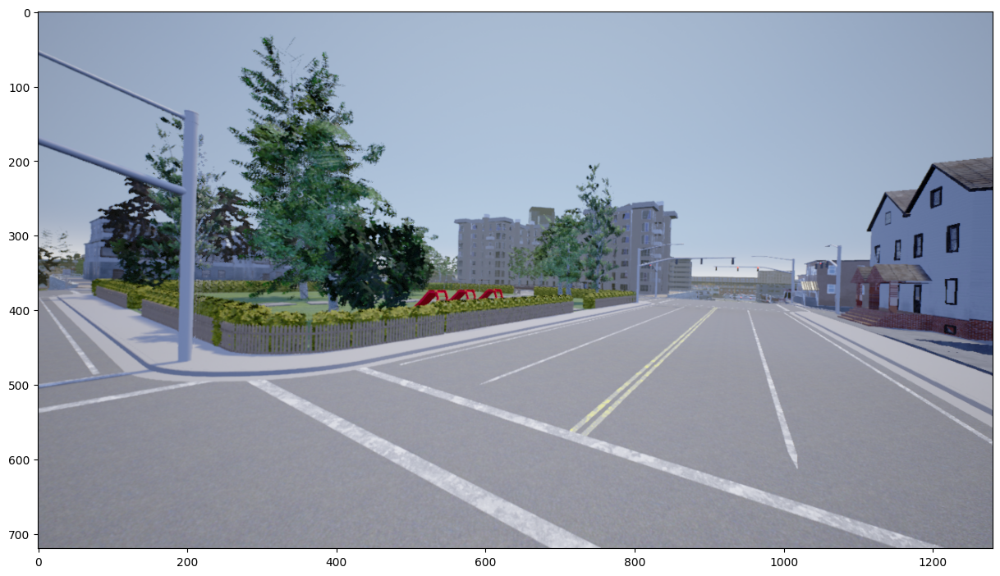

In [3]:
image1 = load_image("image1.png");
plt.imshow(image1)

А также соответствующая ей карта глубины

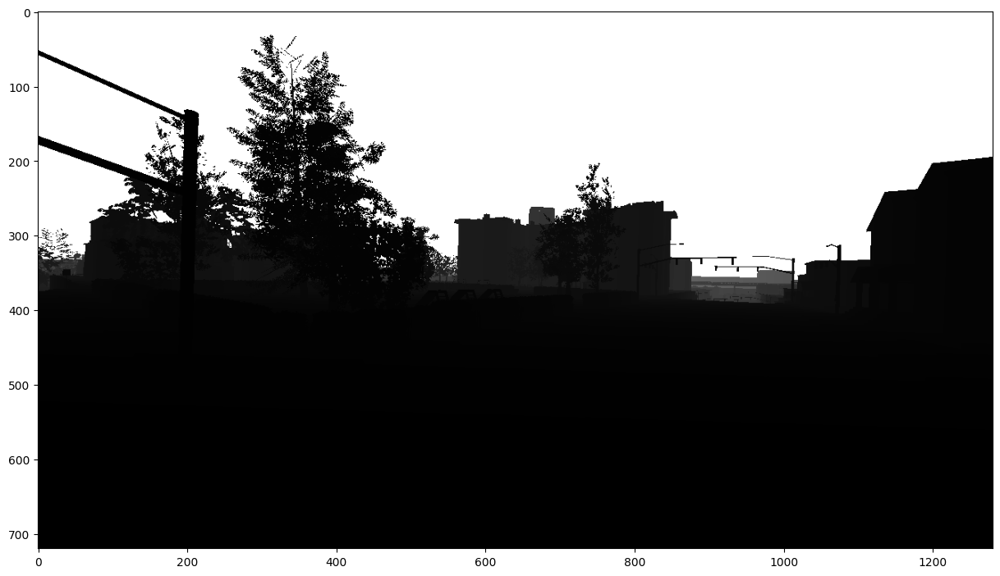

In [4]:
# Глубины даны нормализованными, от 0 до 1, что соответствует расстоянию от 0 до 1000м,
# поэтому здесь мы умножаем на 1000
depth1 = np.load("depth1.npy") * 1000
plt.imshow(depth1, cmap='gray')

Предположим, что мы заранее откалибровали наши камеры (либо калибровка указана в спецификации камеры). Вот эти данные

In [5]:
fx = 448.1551643293023
fy = 448.1551643293023
px = 640.0
py = 360.0

Составьте из этих данных матрицу камеры (формулу можно найти в слайдах)

In [6]:
K = np.array([[fx, 0, px],[0, fy, py],[0, 0, 1]]) # TODO: заполните матрицу камеры
K

array([[448.15516433,   0.        , 640.        ],
       [  0.        , 448.15516433, 360.        ],
       [  0.        ,   0.        ,   1.        ]])

Также далее нам пригодится обратная матрица для матрицы камеры (можно найти ее численной, но советуем воспользоваться аналитической формулой, она есть в слайдах про обратную проекцию)

In [7]:
K_inv = np.array([[1/fx, 0, -px/fx],[0, 1/fy, -py/fy],[0, 0, 1]]) # TODO: заполните обратную матрицу камеры
K_inv

array([[ 0.00223137,  0.        , -1.42807682],
       [ 0.        ,  0.00223137, -0.80329321],
       [ 0.        ,  0.        ,  1.        ]])

Найдём обратную матрицу через встроенныe методы

In [8]:
K_inv_numpy = np.linalg.inv(K) # invariant matrice with numpy
K_inv_scipy = scipy.linalg.inv(K)   # invariant matrice with scipy


Итак, у нас все готово для построения 3D карты из данных первого изображения.
Для этого нам нужна формула обратной проекции со слайда 44.

Давайте присмотримся повнимательнее к этой формуле:

u, v - это координаты пикселя. Мы хотим построить карту из всех пикселей, поэтому нам нужно пробежаться по всем их значениям. Чтобы векторизовать дальнейшие вычисления, будем записывать все по возможности в матрицах.
points_2d - матрица, в которой 2 строки (u и v), и w * h стоблцов, где w и h - размеры изображения. То есть эта матрица будет выглядеть примерно так

| 0 | 1 | 2 | ... | w-1 | 0 | 1 | ... | w-1 |
| --- | --- | --- | --- | --- | --- | --- | --- | --- |
| 0 | 0 | 0 | ... | 0 | 1 | 1 | ... | h-1 |

Проверим какой параметр на изображении отвечает за высоту и за ширину

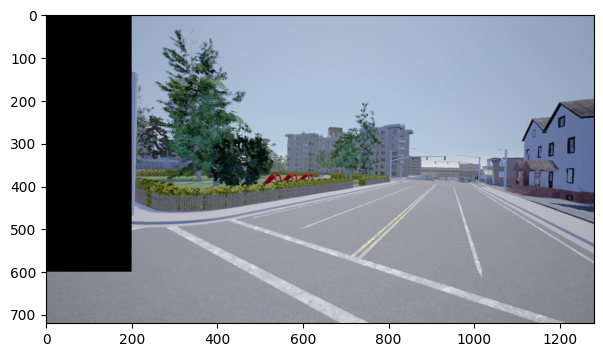

In [9]:
new_image1 = image1.copy()
new_image1[:600,:200,:]=0
plt.figure(figsize=(8,4))
plt.imshow(new_image1)

Соберём матрицу в формате $\begin{bmatrix}u \\ v\end{bmatrix}$ где $u$ отвечает за пиксели по ширине, $v$ за пиксели по высоте

In [10]:
# points_2d = np.array(...) # TODO: заполните марицу с координатами пикселями

print(f"Shape of image1: {image1.shape}")

H, W = image1[:,:,0].shape
x, y = np.arange(H), np.arange(W)
# По условию задания координата u соответствует ширине изображения, 
# а координата v соответствует высоте изображения. Поэтому поменяем в meshgrid аргументы.
X, Y = np.meshgrid(y, x)
X, Y = X.reshape(1, -1),Y.reshape(1, -1)

points_2d = np.concatenate([X, Y], axis=0)
points_2d

Shape of image1: (720, 1280, 3)


array([[   0,    1,    2, ..., 1277, 1278, 1279],
       [   0,    0,    0, ...,  719,  719,  719]])

Отлично, следующий шаг - перейти к однородным координатам. Здесь это просто - добавьте единицу в качестве третьей координаты для каждого пикселя $\begin{bmatrix}u \\ v \\ 1\end{bmatrix}$

In [11]:
# points_2d_h = ... # TODO: переведите points_2d в однородные координаты

# создадим вектрой длиною h*w с единицами и сконкатенируем по 0-ой оси
# Возможно это не обязательно, но держим тип данных np.int32
z_ones = np.ones(shape=(1,(H * W)), dtype=np.int32)
points_2d_h = np.concatenate([points_2d, z_ones], dtype=np.int32 ,axis=0)
points_2d_h


array([[   0,    1,    2, ..., 1277, 1278, 1279],
       [   0,    0,    0, ...,  719,  719,  719],
       [   1,    1,    1, ...,    1,    1,    1]])

Самое время перейти к обратной проекции. Еще раз взгляните на формулу со слайда 44 - что нужно сделать, чтобы из пикселя в однородных координатах получить луч в однородных координатах?

In [12]:
# rays = ... @ points_2d_h # TODO: воостановите формулу для получения матрицы с лучами
rays = np.dot(K_inv, points_2d_h)
# Посмотрим значения для первых трёх пикселей (первые ряд пикселей сверху)
rays[:,:3]

array([[-1.42807682, -1.42584545, -1.42361408],
       [-0.80329321, -0.80329321, -0.80329321],
       [ 1.        ,  1.        ,  1.        ]])

Теперь перейдем к последнему этапу формулы со слайда 36 - применение глубины. Используйте ранее загруженную карту глубины

In [13]:
# cloud1 = rays * ... # TODO: преобразуйте лучи и глубины в 3D точки
# Растянем depth1 как ниточку ширины изображения и умножим на луч в однородных координатах
cloud1 = rays * depth1.reshape(1,-1)

3D точки готовы! Чтобы 3D была красивая, нам также нужны цвета - вытащите их из изображения аналогично points_2d. Там мы добавляли в столбцы координаты пикселей, а здесь так же постройте матрицу, в которой в столбцах будут соответствующие цвета

In [14]:
# colors1 = ... # TODO: постройте матрицу с цветами пикселей в столбцах
# Возможно необходимо так же собрать по пикселям RGB значения
colors1 = image1.reshape(-1,3).transpose()

# Сделаем предварительную проверку по 20 пикселю
colors1[:, 20]==image1[0,20,:]

array([ True,  True,  True])

Предварительная проверка прошла успешно. Окончательную проверку увидим в CC.

Самый простой способ открыть, покрутить и даже обработать облако точек - использовать [CloudCompare](https://www.danielgm.net/cc/release/). Просто запустите ячейку снизу и закиньте полученный файл в CC.

In [15]:
def save_point_cloud(cloud: np.ndarray, colors: np.ndarray, file_name: str) -> None:
    with open(file_name, "w") as file:
        for i in range(cloud.shape[1]):
            file.write(f'{cloud[0, i]}, {cloud[1, i]}, {cloud[2, i]}, {colors[0, i]}, {colors[1, i]}, {colors[2, i]}\n')

In [16]:
save_point_cloud(cloud1, colors1, "cloud1.xyz")

Результат в CC показан на рисунке ниже !["Point Cloud in CC ver1"](./image_hw_1.png)

Уже почти то, что мы хотели получить. Но карту портят далекие точки - небо находится бесконечно далеко, в карте глубины максимальная глубина была 1000м. Отфильтруйте облако и снова откройте в CC

In [17]:
# cloud1_filtered = ... # Отфильтруйте слишком далекие точки
# colors1_filtered = ... # Не забудьте, что цветов тоже стало меньше
cloud1_filtered = cloud1[..., cloud1[2,:] < 200]
colors1_filtered = colors1[..., cloud1[2,:] < 200]

In [18]:
save_point_cloud(cloud1_filtered, colors1_filtered, "cloud1_filtered.xyz")

Результат отфильтрованого изображения в CC показан на рисунке ниже !["Point Cloud in CC ver1"](./image_hw_2.png)

На картинке выше показано, что точки, которые дальше 200 метров удалены. Цвета в облаке точек соответствуют цветам на оригинальном изображении.

Итак, мы получили данные с сенсоров и построили небольшую локульную 3D карту. Машина проехала дальше и мы получили новые данные. Загрузим аналогично данные RGBD камеры

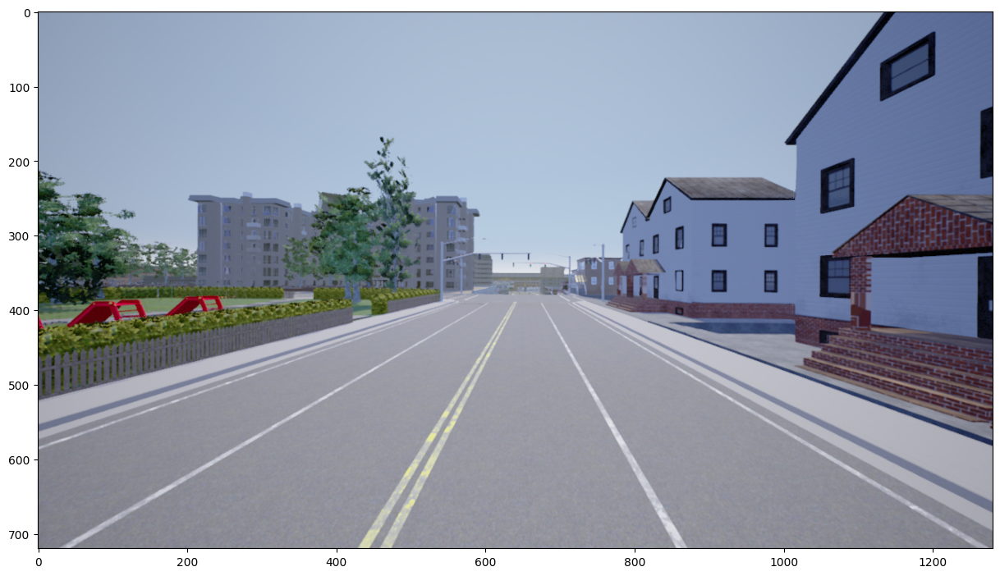

In [20]:
image2 = load_image("image2.png")
plt.imshow(image2)

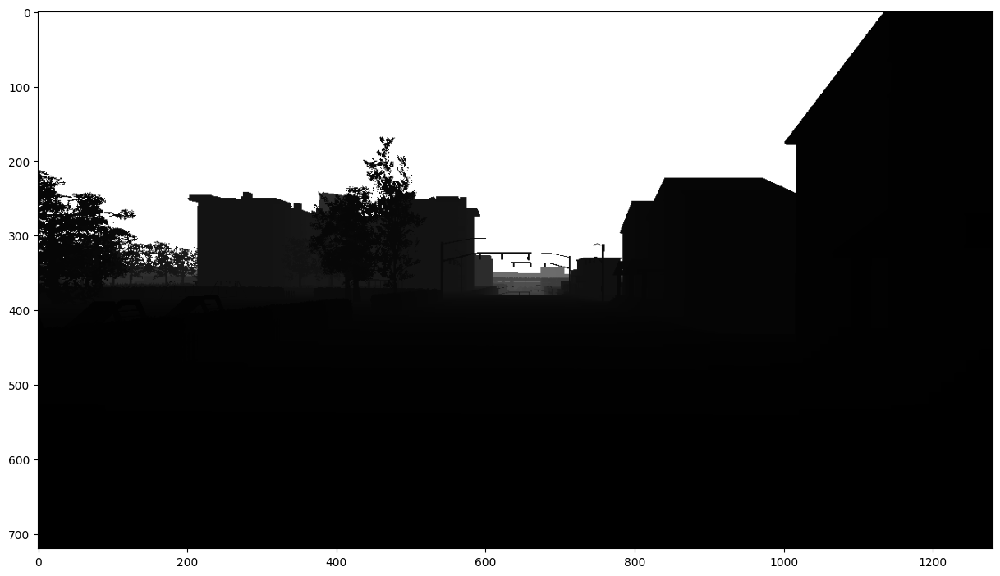

In [21]:
depth2 = np.load("depth2.npy") * 1000
plt.imshow(depth2, cmap='gray')

Хорошо бы знать, как переместился автомобиль между этими кадрами, но этот вопрос будет разбираться в следующих лекциях. Пока мы считаем, что нам эти данные дает сенсор. Чтобы освежить знания, что такое R и t, обратитесь к разделу "Трансформация системы координат" в слайдах.

In [22]:
R = np.array([[ 8.50318515e-01,  2.07742095e-02, -5.25858208e-01],
              [-2.47312245e-02,  9.99694013e-01, -4.97406376e-04],
              [ 5.25686969e-01,  1.34280713e-02,  8.50572100e-01]])

t = np.array([[ 6.51715996e-01,  6.20712517e-03, -6.44666629e+00]]).transpose()

В алгоритмах SLAM/SfM одной их самых частых операций является reproject - перепроецирование точки с кадра на кадр. Давайте попробуем сделать это

Возьмем 3 примечательные точки на первом изображении

In [23]:
landmarks = np.array([
    [560, 856, 1128],
    [280, 276, 313]
])
landmarks

array([[ 560,  856, 1128],
       [ 280,  276,  313]])

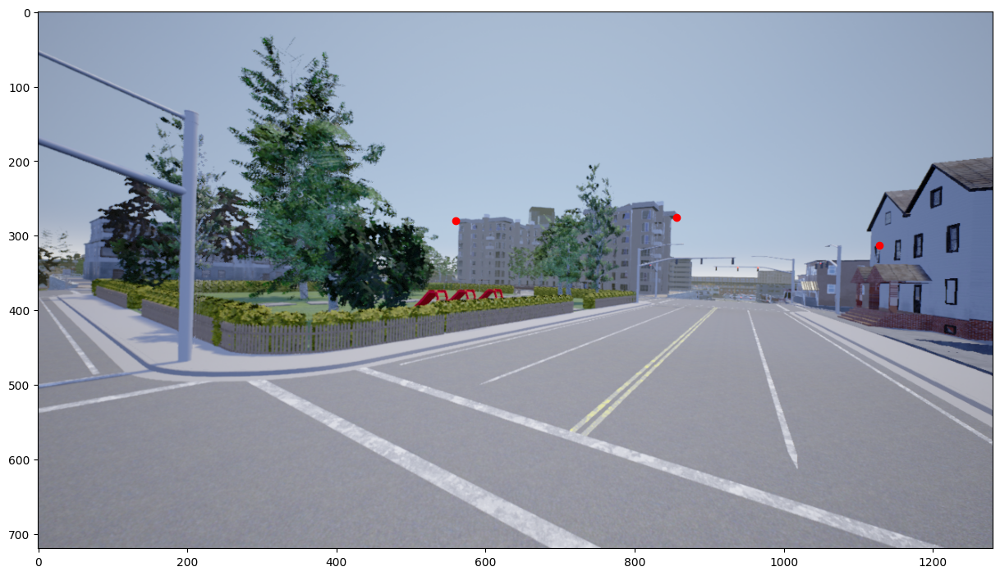

In [24]:
plt.imshow(image1)
plt.plot(landmarks[0, :], landmarks[1, :], "ro", markersize=6)

С помощью аналогичных операций из предыдущих пунктов, преобразуйте это лэндмарки в 3D точки.

Соберём вектор из значений глубин для каждой точки landmark

In [25]:
depth1_list = []
for x,y in zip(landmarks[0,:], landmarks[1,:]):
    depth1_list.append(depth1[y, x])
depth1_landmarks = np.array(depth1_list).reshape(1,-1)
depth1_landmarks

array([[112.01448 ,  90.95443 ,  33.508064]], dtype=float32)

Пересчитаем landmark в 3D точки

In [27]:
# Соберём однородные координаты
landmarks_h = np.concatenate([landmarks, np.ones((1, 3), dtype=np.int32)], axis=0)
# Точки в системе координат камеры
landmarks_3D_rays = np.dot(K_inv, landmarks_h)
# Координаты точек с учётом глубины
landmarks_cloud = landmarks_3D_rays * depth1_landmarks
landmarks_cloud


array([[-19.99566034,  43.83784538,  36.48721841],
       [-19.99566034, -17.04805098,  -3.51413784],
       [112.01448059,  90.95442963,  33.50806427]])

In [28]:
# landmarks_3D_camera1 = ... # получите 3D точки из 2D пикселей
landmarks_3D_camera1 = landmarks_cloud
landmarks_3D_camera1

array([[-19.99566034,  43.83784538,  36.48721841],
       [-19.99566034, -17.04805098,  -3.51413784],
       [112.01448059,  90.95442963,  33.50806427]])

Сохраним точки

In [29]:
landmark1_colors = np.tile([np.array([0, 255, 0])], (3,1))
landmark1_colors

array([[  0, 255,   0],
       [  0, 255,   0],
       [  0, 255,   0]])

In [30]:
save_point_cloud(landmarks_3D_camera1, landmark1_colors.T, "landmarks1_filtered.xyz")

Проверим совпадают ли точки с 3Д миром

Результат отфильтрованого изображения в CC показан на рисунке ниже !["Point Cloud in CC ver1"](./image_hw_3.png)

Мы получили 3D в системе координат, связанной с первой камерой. Самое время преобразовать эти точки так, чтобы отобразить их во вторую камеру. Тут вам пригодятся R и t - матрица поворота и смещение

Образуем матрицу поворота и перемещения

In [31]:
# Создаем матрицу преобразования 4x4
transform_matrix = np.eye(4)
transform_matrix[:3, :3] = R
transform_matrix[:3, 3] = t.T
transform_matrix

array([[ 8.50318515e-01,  2.07742095e-02, -5.25858208e-01,
         6.51715996e-01],
       [-2.47312245e-02,  9.99694013e-01, -4.97406376e-04,
         6.20712517e-03],
       [ 5.25686969e-01,  1.34280713e-02,  8.50572100e-01,
        -6.44666629e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         1.00000000e+00]])

Делаем однородные координаты

In [32]:
landmarks_3D_camera1_h = np.concatenate([landmarks_3D_camera1, np.ones((1, 3))], axis=0)
landmarks_3D_camera1_h

array([[-19.99566034,  43.83784538,  36.48721841],
       [-19.99566034, -17.04805098,  -3.51413784],
       [112.01448059,  90.95442963,  33.50806427],
       [  1.        ,   1.        ,   1.        ]])

Преобразовывыем однородные координаты матрицей поворота
$ \begin{bmatrix} X_{tr} \\ Y_{tr} \\ Z_{tr} \\ 1 \end{bmatrix} = \begin{bmatrix} R & t \\ 0 & 1 \end{bmatrix} \begin{bmatrix} X \\ Y \\ Z \\ 1 \end{bmatrix}$ 

In [33]:
landmarks_3D_camera2 = transform_matrix @ landmarks_3D_camera1_h # преобразуйте landmarks_3D_camera1 во камеру 2.
landmarks_3D_camera2

array([[-75.67009228, -10.25544558,  13.98397931],
       [-19.54453436, -18.16603228,  -4.42589615],
       [ 78.04976446,  93.73269554,  41.18802546],
       [  1.        ,   1.        ,   1.        ]])

А теперь проведем операцию, обратную той, с которой мы начали - спроецируем 3D точки в камеру 2. Вам пригодятся формулы со слайда 22

Для проецирования 3д точек в пиксель необходимо повторить маршрут, который соблюдается при создании изображения камерой. $ \begin{bmatrix} x \\ y \\ 1 \end{bmatrix} = \begin{bmatrix} f_x & 0 & p_x \\ 0 & f_y & p_y \\ 0 & 0 & 1 \end{bmatrix}\begin{bmatrix} 1 & 0 & 0 & 0 \\ 0 & 1 & 0 & 0 \\ 0 & 0 & 1 & 0 \end{bmatrix}\begin{bmatrix} X_{tr} \\ Y_{tr} \\ Z_{tr} \\ 1 \end{bmatrix} $

Инициализируем матрицу проекции, которая выполняет проективное преобразование из 3D однородных координат в 2D однородные координаты. Она описывает процесс перспективной проекции, где трехмерная точка проецируется на плоскость изображения.

In [34]:
M_proj = np.concatenate([np.eye(3), np.zeros((3, 1))], axis=1)
M_proj

array([[1., 0., 0., 0.],
       [0., 1., 0., 0.],
       [0., 0., 1., 0.]])

In [35]:
landmarks_camera2 = K @ M_proj @ landmarks_3D_camera2 # спроецируйте landmarks_3D_camera2 на камеру, вам пригодится матрица камеры K
landmarks_camera2

array([[1.60399066e+04, 5.53928942e+04, 3.26273288e+04],
       [1.93389312e+04, 2.56025692e+04, 1.28442010e+04],
       [7.80497645e+01, 9.37326955e+01, 4.11880255e+01]])

Осталось поделить на Z координату для получения однородных координат

In [36]:
landmarks_camera2 = landmarks_camera2 / landmarks_camera2[-1]
landmarks_camera2

array([[205.50871261, 590.9666198 , 792.15569267],
       [247.77693223, 273.14448885, 311.84308563],
       [  1.        ,   1.        ,   1.        ]])

Нарисуем новые точки на втором изображении. Как мы и ожидали, эти точки принадлежат тем же самым объектам. Из следующих лекций вы узнаете, что обычно задача рещается наоборот - мы сначала находим одни и те же точки на двух изображениях (есть много способов это сделать, этому посвящена вторая лекция), а потом по этой информации восстанавливается поза межлу кадрами (R, t) и глубины точек.

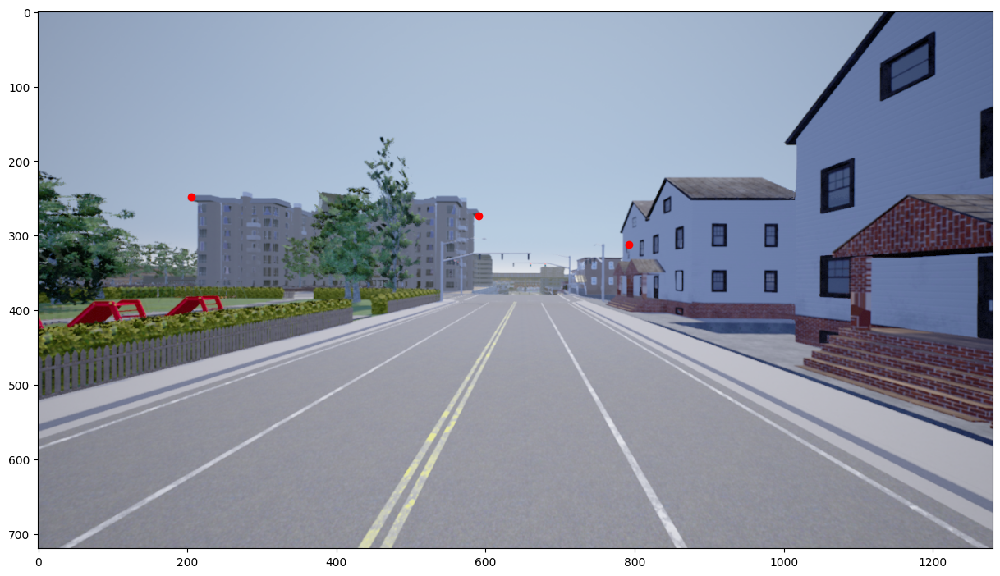

In [37]:
plt.imshow(image2)
plt.plot(landmarks_camera2[0, :], landmarks_camera2[1, :], "ro", markersize=6)

Как видно точки легли на те же самые места, которые были указаны на первом изображении

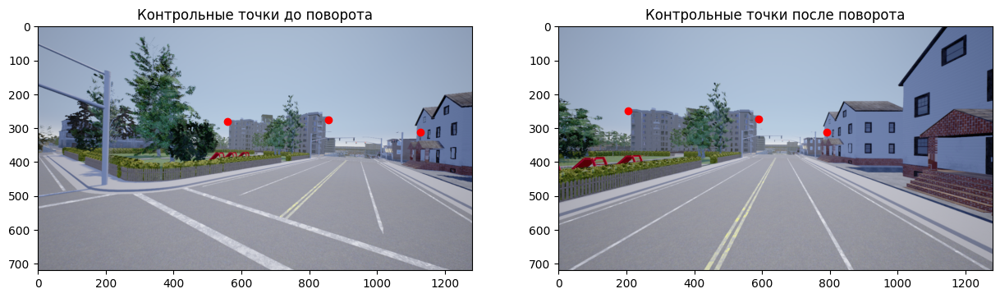

In [38]:
fig, ax = plt.subplots(1, 2, figsize=(15, 10))
ax[0].imshow(image1)
ax[0].plot(landmarks[0, :], landmarks[1, :], "ro", markersize=6)
ax[0].set_title("Контрольные точки до поворота");
ax[1].imshow(image2)
ax[1].plot(landmarks_camera2[0, :], landmarks_camera2[1, :], "ro", markersize=6)
ax[1].set_title("Контрольные точки после поворота");

И последнее, что мы сделаем из наших данных - построим наконец совмещенную 3D карту. Все, что нужно для этого, вы уже проделали: возьмите уже построенную карту из первого изображения cloud1 и преобразуйте ее в систему координат второй камеры

Разница между предыдущим и текущим заданием это количество точек

In [39]:
cloud1_filtered_h = np.concatenate([cloud1_filtered, np.ones(shape=(1, cloud1_filtered.shape[1]))], axis=0)
cloud1_filtered_h.shape

(4, 588907)

In [40]:
cloud1_filtered_camera2 = transform_matrix @ cloud1_filtered_h # преобразуйте cloud1 в систему координат второй камеры с помощью R и t
cloud1_filtered_camera2.shape

(4, 588907)

Проверка самого себя, что поворот облака точек прошёл без проишествий

In [41]:
save_point_cloud(cloud1_filtered_camera2[:3], colors1_filtered, "cloud1_filtered_camera2.xyz")

Теперь просто постройте аналогичное облако точек для второго изображения (второй камеры). Его преобразовывать не нужно, оно уже в системе координат второй камеры. Не забудте его отфильтровать!

In [42]:
# Массив с пикселями остался с прошлого изображения 
image2_rays = K_inv @ points_2d_h
# умножаем на глубину и получаем облако точек для второго изображения
cloud2 = image2_rays * depth2.reshape(1,-1)


In [43]:
cloud2_filtered_camera2 = cloud2[..., cloud2[2] < 200] # постройте cloud2 аналогично тому, как мы строили cloud1
colors2 = image2.reshape(-1, 3).T
colors2_filtered = colors2[..., cloud2[2] < 200] 

In [44]:
cloud2_filtered_camera2.shape, colors2_filtered.shape

((3, 636663), (3, 636663))

In [45]:
cloud1_filtered_camera2[:3].shape, colors1_filtered.shape

((3, 588907), (3, 588907))

Теперь сохраним оба облака в один файл и любуемся ими в CloudCompare - так должно быть видно консистентное облако.

In [46]:
save_point_cloud(np.concatenate((cloud1_filtered_camera2[:3], cloud2_filtered_camera2), axis=1),
                 np.concatenate((colors1_filtered, colors2_filtered), axis=1), "cloud2.xyz")

<p float="left">
  <img src="image_hw_4.png" alt="Was" width="500" />
  <img src="image_hw_5.png" alt="Became" width="500" />
</p>

Как можно увидеть, что изображения наложились хорошо. Полосы без искажений и благодаря другому ракурсу, изображение стало более информативно.

### Гомография (20 баллов максимум)

Используя полученные на лекции новые знания, сделаем простейший выравниватель документов. Перво-наперво, нам нужна фотография документа, который мы будем выравнивать. Можете сфотографировать его сами, можете взять готовый образец.

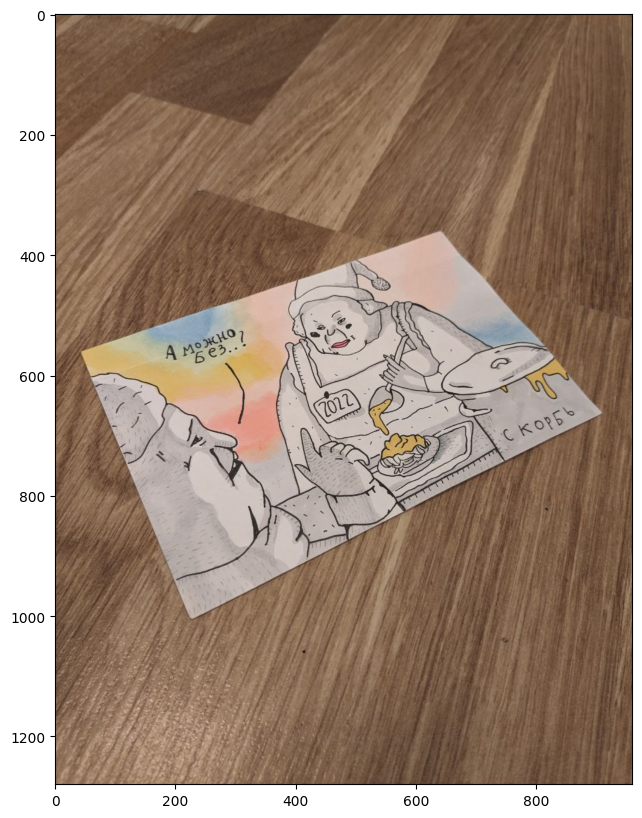

In [47]:
image = load_image("doc.jpg")
plt.imshow(image)

Напишем функцию для определения углов документа

In [48]:
def find_image_corners(image: np.ndarray) -> np.ndarray:
    # Поиск углов документа на изображении с помощью OpenCV
    orig_image = image.copy()
    # Преобразуем в оттенки серого
    gray_image = cv2.cvtColor(orig_image, cv2.COLOR_RGB2GRAY)
    # Устаняем шум через размытие
    blurred_image = cv2.bilateralFilter(gray_image, 11, 17, 17)
    # Поиск краёв через алгоритм Canny
    edges = cv2.Canny(blurred_image, 30, 200)
    # Поиск контуров
    kernel = np.ones((5, 5), np.uint8)
    dilated = cv2.dilate(edges, kernel, iterations=2)
    closed = cv2.morphologyEx(dilated, cv2.MORPH_CLOSE, kernel)

    cnts, _ = cv2.findContours(closed, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    # Сортировка контуров по площади
    cnts = sorted(cnts, key=cv2.contourArea, reverse=True)

    # Ищем четырёх угольник, который будет контуром документа
    document_contour = None
    for c in cnts:
        # Найти аппроксимацию контура
        perimeter = cv2.arcLength(c, True)
        approx = cv2.approxPolyDP(c, 0.045 * perimeter, True)

        # Если в контуре четыре вершины, значит это контур документа/изображения
        if len(approx)==4:
            document_contour = approx
            break
    
    if document_contour is None:
        raise ValueError("Документа на изображении нет/Не удалось найти контур документа")
    
    # Перестановка углов в определённом порядке (вл->вп->нп->нл)
    def order_points(pts):
        rect = np.zeros((4,2), dtype="float32")
        s = pts.sum(axis=1)
        rect[0]=pts[np.argmin(s)] # вл
        rect[2]=pts[np.argmax(s)] # нп

        diff = np.diff(pts, axis=1)
        rect[1]=pts[np.argmin(diff)] # вп
        rect[3]=pts[np.argmax(diff)] # нл

        return rect
    
    # Найдем координта углов
    corners = order_points(document_contour.reshape(4,2))

    # Нарисуем углы на изображении для проверки
    for (x,y) in corners:
        cv2.circle(orig_image, (int(x), int(y)), 10, (0,255,0), -1)

    # Показать результат
    plt.imshow(orig_image)

    return corners


С помощью функции написанной выше, найдём углы документа

[[  39.  643.  911.  222.]
 [ 559.  356.  656. 1008.]]


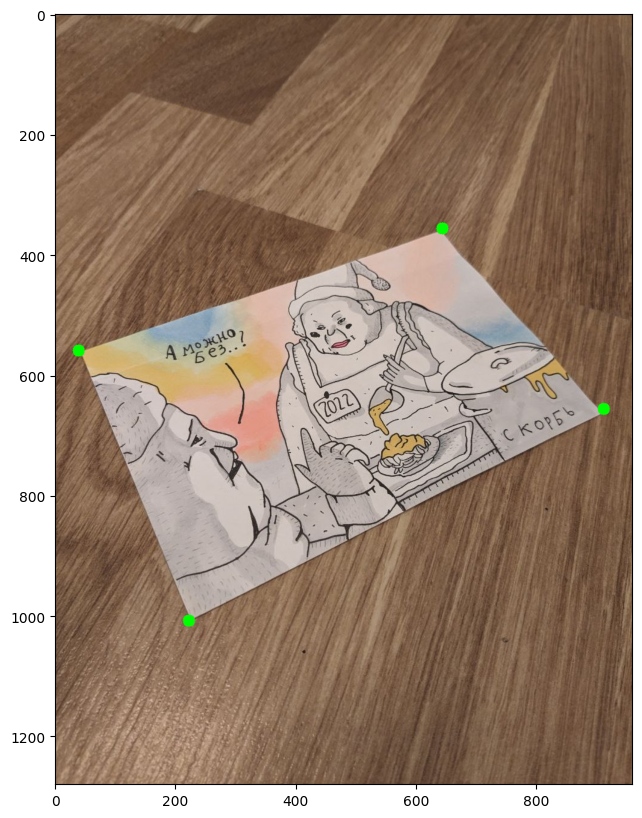

In [49]:
corners = find_image_corners(image)
print(corners.T)

[[  0. 600. 600.   0.]
 [  0.   0. 400. 400.]]


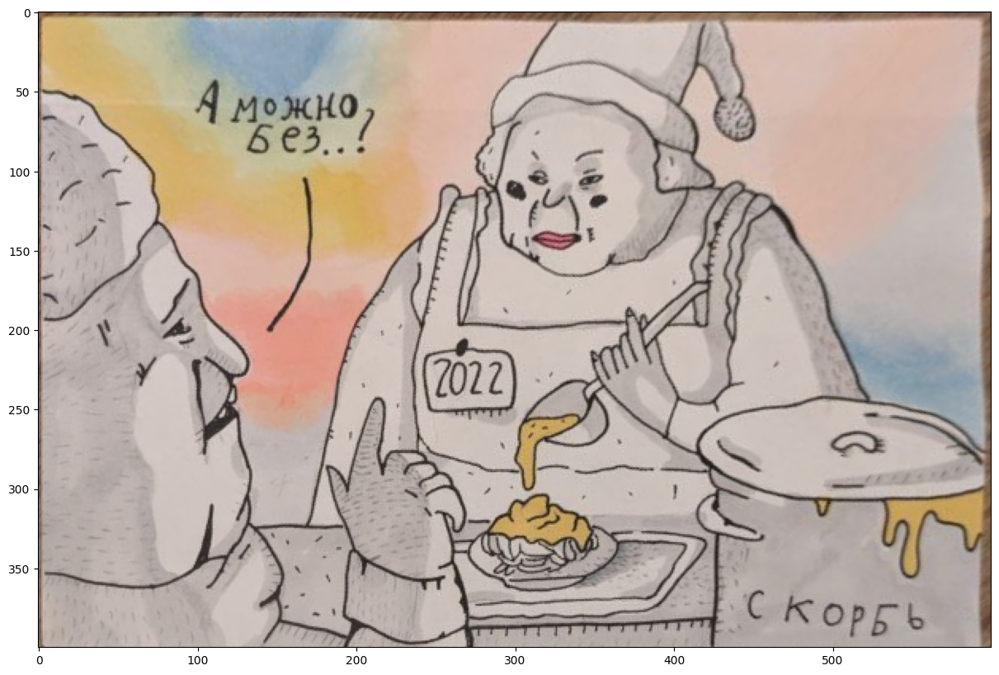

In [50]:
# Зададим точки в которые будем проецировать интересующий нас контур
width, height = 600, 400
destination_corners = np.array([[0, 0], [width, 0], [width, height], [0, height]], dtype="float32")
print(destination_corners.T)

# Зададим матрицу гомографии
M = cv2.getPerspectiveTransform(corners, destination_corners)

# Преобразовываем оригинальное изображение через матрицу гомографии в прямоугольник
warped_image = cv2.warpPerspective(image, M, (width, height))

# Результат
plt.imshow(warped_image)

Комментарии к задаче. Необходимо немного доработать алгоритм по поиску граней, для оптимального определения изображения. Как видно из результата, то в проекцию все ещё попадает стол, чего быть не должно.

Для начала нам нужно определить углы документа. Их можно найти автоматически, но предлагаем не отвлекаться на эту задачу, она относится чисто к 2D. Поэтому сделаем это просто руками. Отсчет ведем от левого верхнего угла и по часовой стрелке

In [51]:
pts_src = np.array([[43, 562], [640, 360], [907, 663],[227, 1005]])
pts_src.T

array([[  43,  640,  907,  227],
       [ 562,  360,  663, 1005]])

Погрешность между найденными и данными по заданию угловыми точками

In [52]:
(corners-pts_src).T

array([[-4.,  3.,  4., -5.],
       [-3., -4., -7.,  3.]])

Далее нужно определить, в какие точки мы будем отображать эти углы - сделайте это самостоятельно. Предполагается, что в итоге мы хотим увидеть прямоугольник

In [53]:
# pts_dst = np.array( ... ) # Определите желаемое положение для каждого угла
# Зададим желаемы точки для проецирования в том же виде, что и точки на картинке вп->вл->нп->нл

pts_dst = np.array([[0, 0], [width, 0], [width, height], [0, height]], dtype="float32")
pts_dst.T

array([[  0., 600., 600.,   0.],
       [  0.,   0., 400., 400.]], dtype=float32)

Теперь мы можем найти гомографию по четырем соответсвиям между точками. Вам предлагается сделать это двумя способами - базово, с использованием OpenCV метода (пример можно найти [здесь](https://learnopencv.com/homography-examples-using-opencv-python-c/)) и продвинуто, с помощью самописной функции DLT (подробнее смотрите слайд 16). Можно легко найти уже написанные функции поиска гомографии с помощью DLT, поэтому снабжайте код пояснениями, чтобы было понятно, что вы разбрались, что происходит в коде.  За каждую функцию начисляется 5 баллов.

In [54]:
def find_homography_opencv(src_pts: np.ndarray, dst_pts: np.ndarray) -> np.ndarray:
    # Реальзуйте вычсиление гомографии с помощью OpenCV
    h, status = cv2.findHomography(pts_src, pts_dst)
    return h

def find_homography_custom(src_pts: np.ndarray, dst_pts: np.ndarray) -> np.ndarray:
    # Реальзуйте вычиcление гомографии с помощью запописного метода
    #-------------------Блок формирования матрицы A-------------------#
    A = []
    for i in range(pts_src.shape[0]):
        # Мы принимаем два набора точек: pts_src and pts_dst
        x, y = pts_src[i, 0], pts_src[i, 1]  # Координаты точки из первого изображения
        x_prime, y_prime = pts_dst[i, 0], pts_dst[i, 1]  # Координаты точки из второго изображения
        # Для каждой пары точек формируем две строки в матрице 𝐴 по формулам ниже.
        A.append([-x, -y, -1, 0, 0, 0, x_prime * x, x_prime * y, x_prime])
        A.append([0, 0, 0, -x, -y, -1, y_prime * x, y_prime * y, y_prime])

    # Convert A to array
    A = np.asarray(A)
    #-------------------Блок формирования матрицы A-------------------#
    
    # Выполняем SVD
    _, _, V = np.linalg.svd(A)

    # Нахождения наименьшего собственного вектора через SVD
    # Последний столбец матрицы V — это наименьший собственный вектор
    # Это решение системы A h = 0
    H = V[-1, :].reshape((3, 3))

    # Нормализуем матрицу так, чтобы последний элемент был равен 1
    H = H / H[-1, -1]
    return H
    
    

In [55]:
H = find_homography_opencv(pts_src, pts_dst)
H_custom = find_homography_custom(pts_src, pts_dst)
H

array([[ 1.11580610e+00, -4.63449936e-01,  2.12479202e+02],
       [ 5.26020372e-01,  1.55462456e+00, -8.96317881e+02],
       [-1.41325248e-04,  9.90842695e-04,  1.00000000e+00]])

Сравним результаты двух функций

In [56]:
np.isclose(H_custom, H, atol=1e-3).all()

True

Сравнение самописной и библиотечной функции показывают одинаковые результаты с погрешностью в 0.001

Зная гомографию, мы можем применить ее к изображению. Опять же, предлагается начать с готового метода из OpenCV (снова предлагается [этот](https://learnopencv.com/homography-examples-using-opencv-python-c/) пример). После этого можно попробовать написать кастомное преобразование изображения с помощью гомографии. За каждую функцию начисляется 5 баллов.

In [58]:
def warp_perspective_opencv(image: np.ndarray, H: np.ndarray, dsize: np.ndarray) -> np.ndarray:
    # Реализуйте преобразование изображения с помощью OpenCV. Вам понадобятся
    # image - изначальное изображение
    # H - гомография
    # dsize - размер конечного изображения
    im_out = cv2.warpPerspective(image, H, dsize)
    return im_out

def warp_perspective_custom(image: np.ndarray, H: np.ndarray, dsize: np.ndarray) -> np.ndarray:
    # Реальзуйте кастомное преобразование изображения. Вам понадобятся
    # image - изначальное изображение
    # H - гомография
    # dsize - размер конечного изображения
    # Инициализируем пустое выходное изображение
    width, height = dsize
    transformed_image = np.zeros(shape=(height, width, 3), dtype=image.dtype)
    H_inv = np.linalg.inv(H)

    # Проходим по каждому пикселю изображения
    for i in range(height):
        for j in range(width):
            # Создаём координаты пикселя в однородных координатах
            point = np.array([j, i, 1])
            
            # Применяем обратную гомографию
            point_h = np.dot(H_inv, point)

            # Нормализуем координаты
            point_h = point_h / point_h[2]
            x_h, y_h = point_h[0], point_h[1]

            if 0 <= x_h < width and 0 <= y_h < height:
                # Округляем до ближайшего соседа
                x_h = int(round(x_h))
                y_h = int(round(y_h))
                # Переносим значение пикселя в новое изображение
                transformed_image[i,j]=image[y_h, x_h]
        
    return transformed_image

Вариант преобразования с матрицей гомографии и дальнейшим масштрабированием в нужный нам размер

In [59]:
def warp_perspective_custom_2(image: np.ndarray, H: np.ndarray, dsize: np.ndarray) -> np.ndarray:
    # Реальзуйте кастомное преобразование изображения. Вам понадобятся
    # image - изначальное изображение
    # H - гомография
    # dsize - размер конечного изображения
    # Инициализируем пустое выходное изображение
    w, h,  = dsize
    H_inv = np.linalg.inv(H)
    transformed_image = np.zeros(shape=(h, w, 3), dtype=image.dtype)
    # Проходим по каждому пикселю изображения
    for i in range(h):
        for j in range(w):
            # Создаём координаты пикселя в однородных координатах
            point = np.array([j, i, 1])
            
            # Применяем обратную гомографию
            point_h = np.dot(H_inv, point)

            # Нормализуем координаты
            point_h = point_h / point_h[2]
            x_h, y_h = point_h[0], point_h[1]

            if 0 <= x_h < w and 0 <= y_h < h:
                # Округляем до ближайшего соседа
                x_h = int(round(x_h))
                y_h = int(round(y_h))
                # Переносим значение пикселя в новое изображение
                transformed_image[i,j]=image[y_h, x_h]

    transformed_image = cv2.resize(transformed_image, (600, 400), interpolation=cv2.INTER_AREA)
        
    return transformed_image

Применение преобразование изображения с помощью OpenCV и гомографии, найденной через библиотеку OpenCV

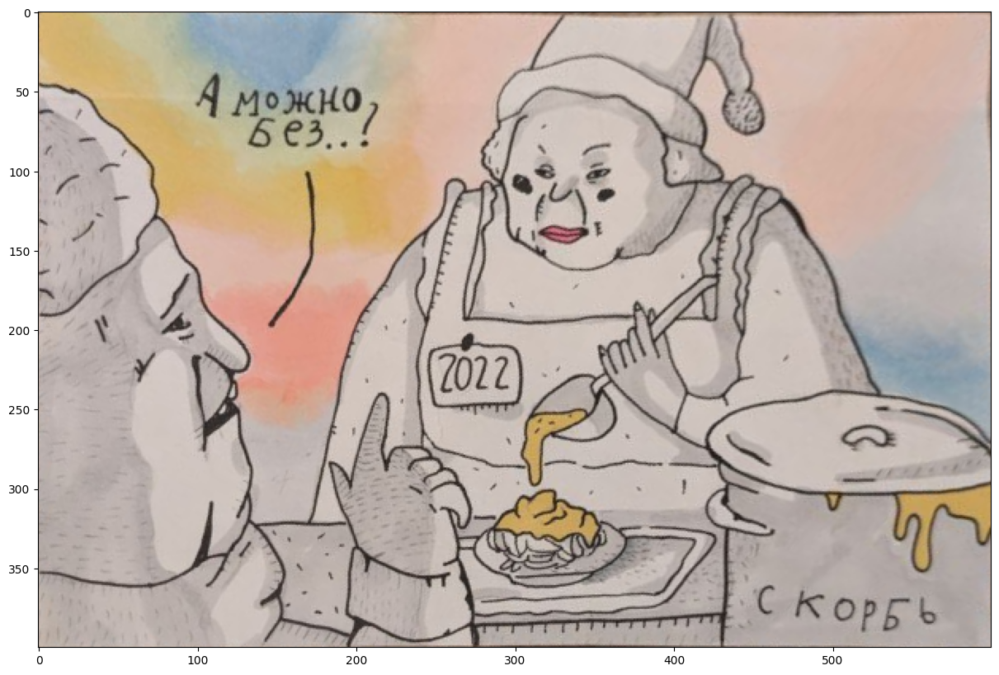

In [60]:
dsize = (width, height) # размеры нового изображения
im_out = warp_perspective_opencv(image, H, dsize)
plt.imshow(im_out)

Комментарии к ответу. Как можно увидеть встроенные библиотеки работают отлично работают с выходным изображением размерность которого меньше чем исходное выражение. Также наблюдается хорошее качество картинки, благодаря интерполяции между соседними точками.

Применение преобразование изображения с помощью собственного кода

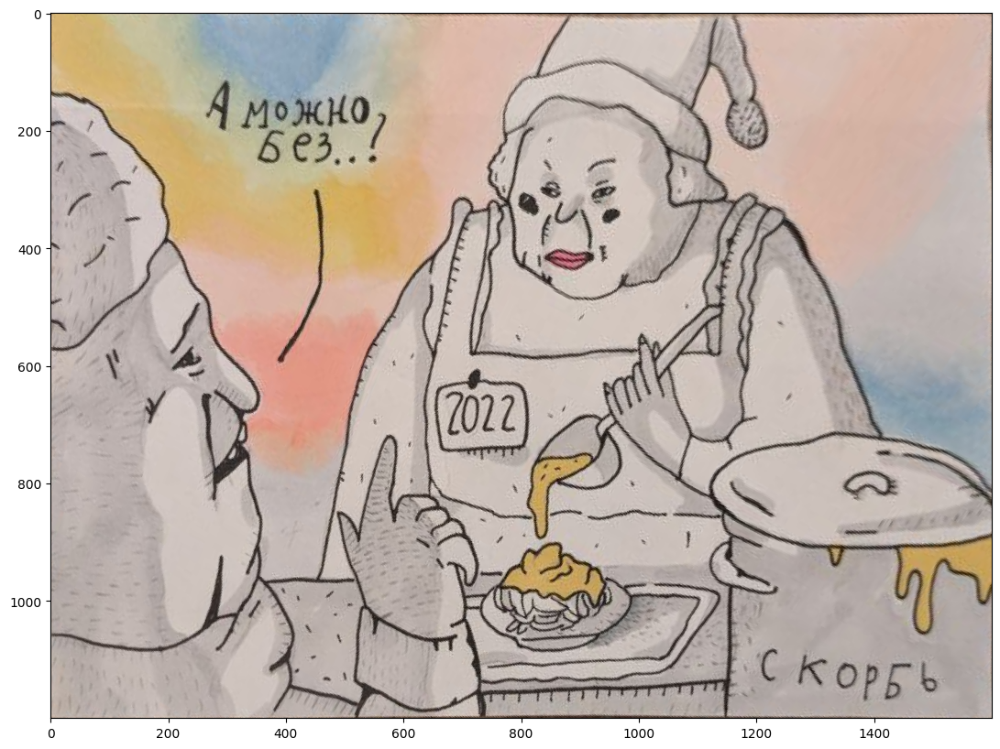

In [61]:
width, height = 1600, 1200
pts_dst = np.array([[0, 0], [width, 0], [width, height], [0, height]], dtype="float32")
H_custom = find_homography_custom(pts_src, pts_dst)
im_out = warp_perspective_custom(image, H_custom, (width, height))
plt.imshow(im_out)

Комментарии к ответу. Как можно увидеть самописный код показывает хороший уровень проецирования изображения, но требует, чтобы размер выходного изображения был больше исходного, что приводит к ухудшению качества.

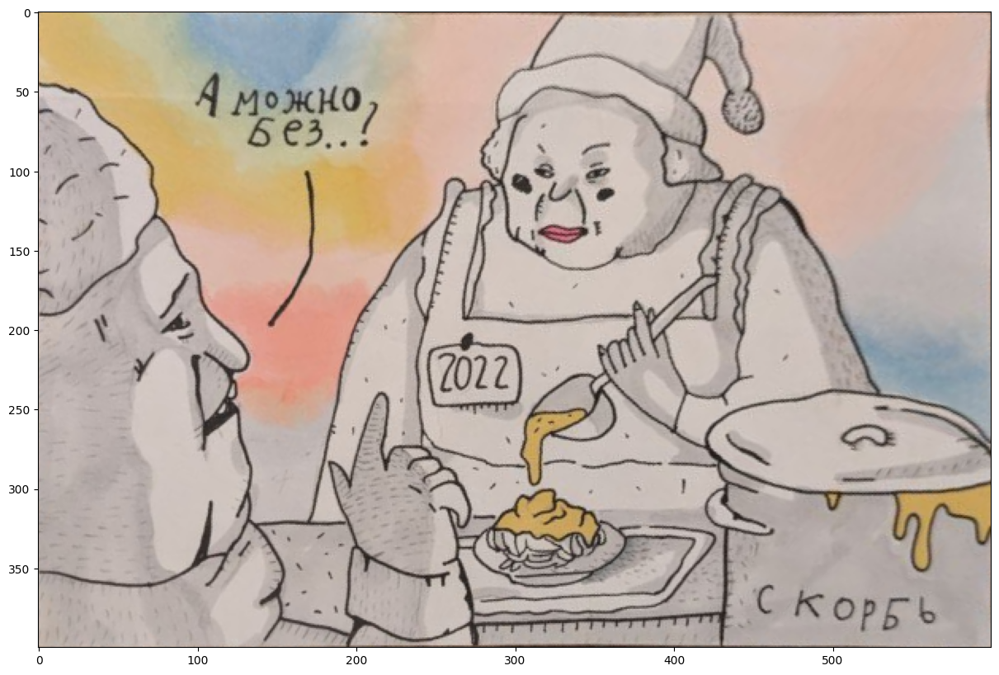

In [62]:
im_out = warp_perspective_custom_2(image, H_custom, (width, height))
plt.imshow(im_out)

Комментарии к ответу. На данном изображении применяется масштабирование до желаемых размеров, которые использовались в встроенных библиотеках - (400б 600)

### Калибровка (5 баллов)

В данном разделе вам предлагается сделать калибровку камеры своего мобильного телефона. Как мы выяснили на занятии, для этого необходима калибровочная доска. Идеальным вариантом будет вывод шахматной доски на экран компьютера, так как он является настолько плоским, насколько это возможно в быту.
Генераторов досок в интернете предостаточно, откройте например [этот](https://markhedleyjones.com/projects/calibration-checkerboard-collection). Далее произведите серию снимков с телефона.

Общие рекомендации:
* Делайте побольше снимков. На практике часто снимают видео, но это на ваше усмотрение. Зависит от желания заморачиваться с распаковкой кадров и прореживанием их.
* Постарайтесь захватить максимум ракурсов: ближе/дальше, выбирайте разные углы наклона, вращайте камеру, постарайтесь захватить всё поле зрение камеры.
* На каждом снимке должна быть видна вся доска. На лекции мы обсуждали почему это важно для обычной доски, здесь просто напоминаю.

Далее проделайте калибровку с помощью стандартных методов OpenCV, пример можно найти [здесь](https://docs.opencv.org/4.x/dc/dbb/tutorial_py_calibration.html) или в миллионе других мест.

Попробуйте убрать дисторсию с помощью функции undistort. Стало ли лучше? Если стало только хуже, обратитесь к рекомендациям по съёмке для калибровки снова.

**Решение**

Как написано в документации по калибровке камеры от OpenCV, для наилучшего результат необходимо 10 фотографий шахматной доски (какого-то паттерна).

По указанному пути найденно 30 изображений


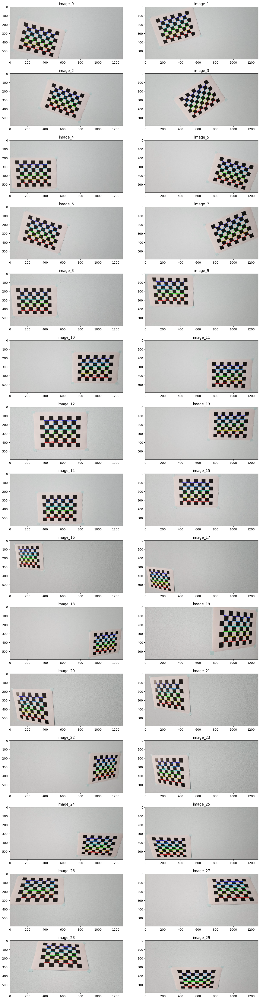

In [63]:
path_to_images = os.path.join(os.getcwd(), "images_calibration")
# Критерий остонова
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
 
# Подготовка точек объекта в виде (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((8*6,3), np.float32)
objp[:,:2] = np.mgrid[0:8,0:6].T.reshape(-1,2)
 
# Инициализируем массивы для хранения точек объектов и изображения.
objpoints = [] # трехмерная точка в реальном пространстве
imgpoints = [] # двумерные точки на плоскости изображения.
 
path_to_images = "C:\\Users\\SKG\\GitHub\\3D_ComputerVision\\camera_model_and_calibration\\homework\\images_calibration3"
images = os.listdir(path_to_images)
# Сортировка списка, чтобы исключить откалиброванные изображения
images = [image for image in images if "calib_" not in image]
print(f"По указанному пути найденно {len(images)} изображений")


fig, ax = plt.subplots(15, 2, figsize=(15, 60)) 

for i, fname in enumerate(images):
    img = cv2.imread(os.path.join(path_to_images, fname))
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Ищем углы шахматной доски
    ret, corners = cv2.findChessboardCorners(gray, (8,6), None)

    # Если найдено, добавьте точки объекта, точки изображения (после их уточнения).
    if ret == True:
        objpoints.append(objp)

        corners2 = cv2.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners2)

        # Рисуем углы и доски
        cv2.drawChessboardCorners(img, (8,6), corners2, ret)
        # plt.imshow('img', img)
        ax[i//2,i%2].imshow(img)
        ax[i//2,i%2].set_title(f"image_{i}")

 


Калибровка камеры

In [66]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
print("Матрица камеры:")
print(mtx)
print("Коэффициенты искажений:")
print(dist)

Матрица камеры:
[[852.73151664   0.         625.12846022]
 [  0.         850.20575219 290.21089805]
 [  0.           0.           1.        ]]
Коэффициенты искажений:
[[ 0.10300671 -0.18221187 -0.00082262 -0.00384526  0.07737231]]


Как можно увидеть из строчки выше, что коэффициенты принимают небольшие значения
$$x_{distorted}​=x(1+k_1​r^2+k_2​r^4+k_3​r^6+…)$$
$$y_{distorted}=y(1+k_1r^2+k_2r^4+k_3r^6+… )$$

$$x_{distorted}​=x+[2p_1​xy+p_2​(r^2+2x^2)]$$
$$y_{distorted}=y+[p_1(r^2+2y^2)+2p_2xy]$$

$$dist = [k_1,k_2,p_1,p_2,k3]$$

Исправление искажений на изображении

In [67]:
img = cv2.imread(os.path.join(path_to_images, images[6]))
h, w = img.shape[:2]
newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))
print("Новая матрица камеры:")
print(newcameramtx)
print("ROI:")
print(roi)

Новая матрица камеры:
[[860.45416664   0.         618.39905427]
 [  0.         852.84762635 289.48533521]
 [  0.           0.           1.        ]]
ROI:
(2, 5, 1273, 580)


Коррекция искажений

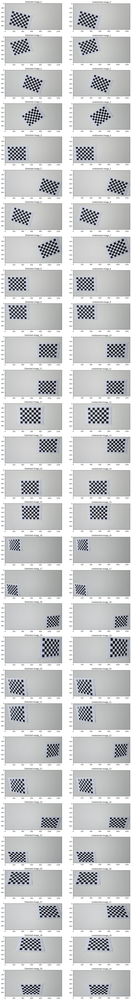

In [68]:
fig, ax = plt.subplots(30, 2, figsize=(15, 120)) 

for i, fname in enumerate(images):
    img = cv2.imread(os.path.join(path_to_images, fname))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Отображаем изображение в первом столбце
    ax[i, 0].imshow(img)
    ax[i, 0].set_title(f"Distorted image_{i}")

    h, w = img.shape[:2]

    # убираем искажения
    dst = cv2.undistort(img, mtx, dist, None, newcameramtx)

    # обрезаем изображение
    x, y, w, h = roi
    dst = dst[y:y+h, x:x+w]

    # Отображаем изображение в первом столбце
    ax[i, 1].imshow(dst)
    ax[i, 1].set_title(f"Undistorted image_{i}")

    # Сохраняем изображение
    calib_image = "calib_" + fname
    cv2.imwrite(os.path.join(path_to_images, calib_image), dst)


Несмотря на незначительную дисторсию самой камеры, видно что на изображении 17 изображение стало менее искажённым. Также хочется отметить хорошую камеру samsunga s23, которая показывает малую дисторсию. Ходил вокруг шахматной достки на белой стене, чтобы найти искривлённое изображение, но так и не нашёл, чтобы это было очевидно выраженно.

Этот код вычисляет среднюю ошибку калибровки камеры на основе отклонения между спроецированными точками и реальными точками изображения.

In [69]:
mean_error = 0
for i in range(len(objpoints)):
    imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
    error = cv2.norm(imgpoints[i],imgpoints2, cv2.NORM_L2)/len(imgpoints2)
    mean_error += error

print("total error: ", mean_error/len(objpoints))

total error:  0.04823770434712131


Посмотрим алгоритм remapping

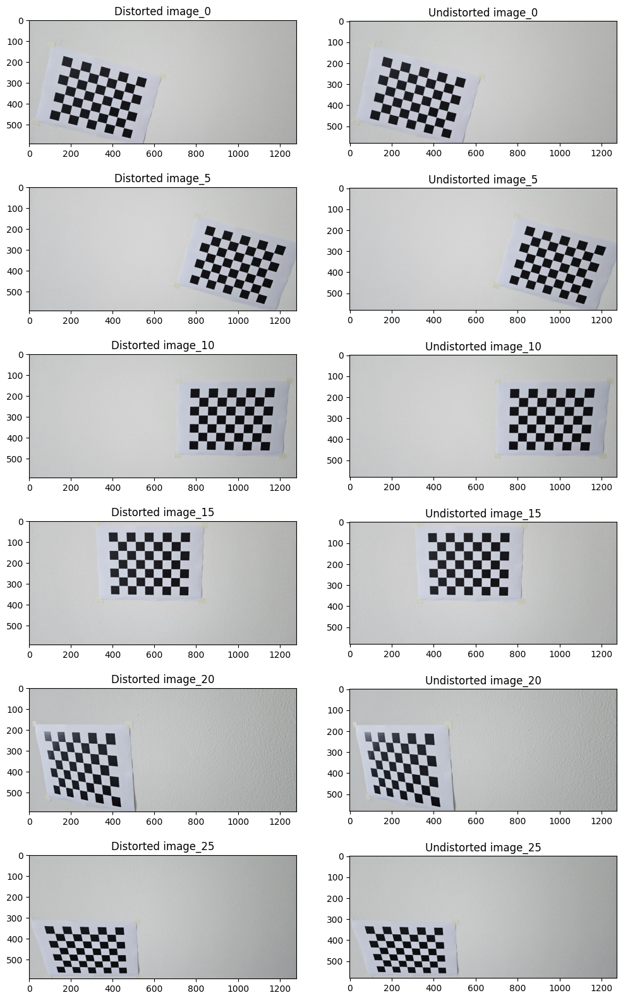

In [70]:
fig, ax = plt.subplots(6, 2, figsize=(12, 20)) 

for i, fname in enumerate(images):
    if i % 5 == 0:
        img = cv2.imread(os.path.join(path_to_images, fname))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Отображаем изображение в первом столбце
        
        ax[i//5, 0].imshow(img)
        ax[i//5, 0].set_title(f"Distorted image_{i}")

        h, w = img.shape[:2]

        # убираем искажения
        mapx,mapy = cv2.initUndistortRectifyMap(mtx,dist,None,newcameramtx,(w,h),5)
        dst = cv2.remap(img,mapx,mapy,cv2.INTER_LINEAR)

        # обрезаем изображение
        x, y, w, h = roi
        dst = dst[y:y+h, x:x+w]

        # Отображаем изображение в первом столбце
        ax[i//5, 1].imshow(dst)
        ax[i//5, 1].set_title(f"Undistorted image_{i}")

        # Сохраняем изображение
        # calib_image = "calib_" + fname
        # cv2.imwrite(os.path.join(path_to_images, calib_image), dst)